# Overviewing simulation

(retry after updating the `dataplot` module)

In [1]:
import json, gzip

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from ete3 import Tree

from colaml import *
from colaml.misc import dataplot, modelplot
from myconfig import DATASET_DIR

In [2]:
from threadpoolctl import threadpool_limits
threadpool_limits(1, user_api='blas')

In [3]:
SIM01_DIR = DATASET_DIR/'01-simulation01'
conditions = pd.read_csv(SIM01_DIR/'conditions.tsv', sep='\t')

## Overviewing synthetic data

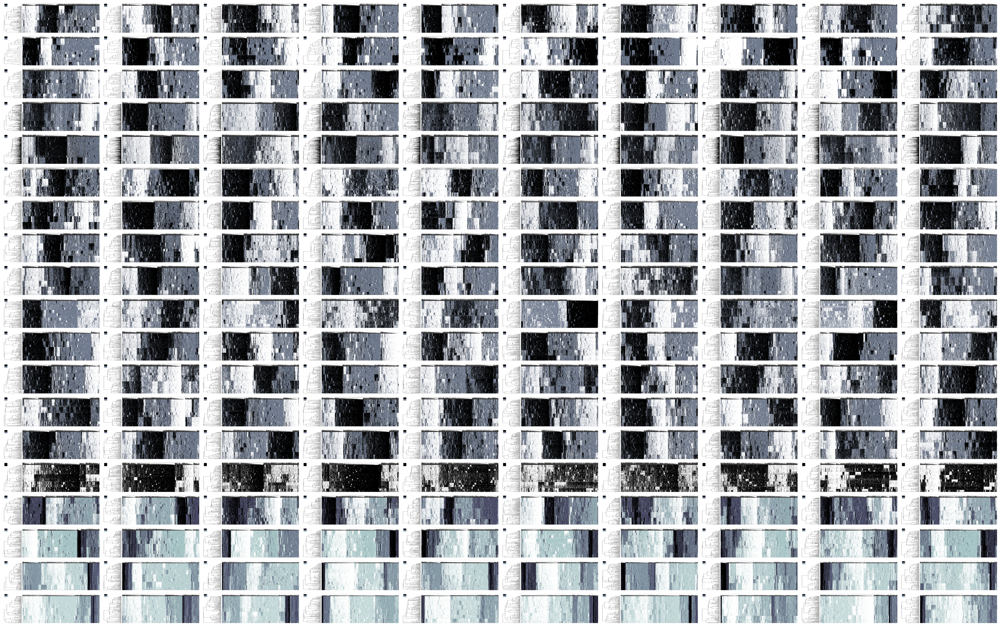

In [4]:
fig, axes = plt.subplots(
    len(conditions), 10, sharex='row', sharey='row', 
    layout='constrained', gridspec_kw=dict(wspace=0.02, hspace=0.02), 
    figsize=(40, 25), dpi=100
)

for ax in axes.flatten():
    ax.set_axis_off()
    ax.set_frame_on(False)

for cond, axr in zip(conditions.itertuples(index=False), axes):
    for rep, ax in zip(range(1, 11), axr):
        with gzip.open(SIM01_DIR/cond.conditionID/f'{cond.conditionID}-rep{rep:02d}.json.gz') as file:
            data = json.load(file)
            
        tindex = PostorderSerializedTree(Tree(data['tree'], format=3))
        OGs = pd.DataFrame(**data['OGs']).to_dict(orient='index')
        sim = ExtantPhyTable(OGs, tindex)
        
        # extract RGB
        clst = dataplot.draw_extant(sim)
        subfig = clst.fig
        subfig.canvas.draw()
        width, height = map(int, subfig.get_size_inches() * subfig.get_dpi())
        rgb = np.frombuffer(subfig.canvas.tostring_rgb(), dtype='uint8').reshape(height, width, 3)
        plt.close(subfig)
        
        ax.imshow(rgb, aspect='auto')

Note that figsizes are not adjusted by dataset size, so scale varies among rows.

## Overviewing parameters

In [5]:
def plotMMM(treemodel, fig):
    from matplotlib.colors import LogNorm
    axes = fig.subplot_mosaic(
        'AB\nAC', height_ratios=[1,3], width_ratios=[1.1,0.9], gridspec_kw=dict(hspace=0.1, wspace=0.1))
    modelplot.plot_substmodel(
        treemodel.substmodel, ax=axes['A'], 
        norm=LogNorm(vmin=0.0025, vmax=0.25), annot_kws=dict(fontsize='x-small')
    )

    bx, by, bw, bh = axes['A'].get_position().bounds
    axes['A'].set_position([bx + bw * 0.06, by, bw * 0.94, bh * 0.94])
        
    pd.DataFrame([treemodel.cat_root_probs]).plot.barh(ax=axes['B'], stacked=True, legend=None, width=1)
    axes['B'].set(xlim=(0, 1), ylim=(-0.5, 0.5))
    pd.DataFrame(treemodel.cpy_root_probs).plot.bar(stacked=True, width=0.95, ax=axes['C'], legend=None, cmap='copper')
    axes['C'].set(ylim=(0, 1), xlim=(-0.5, treemodel.ncategories-0.5))

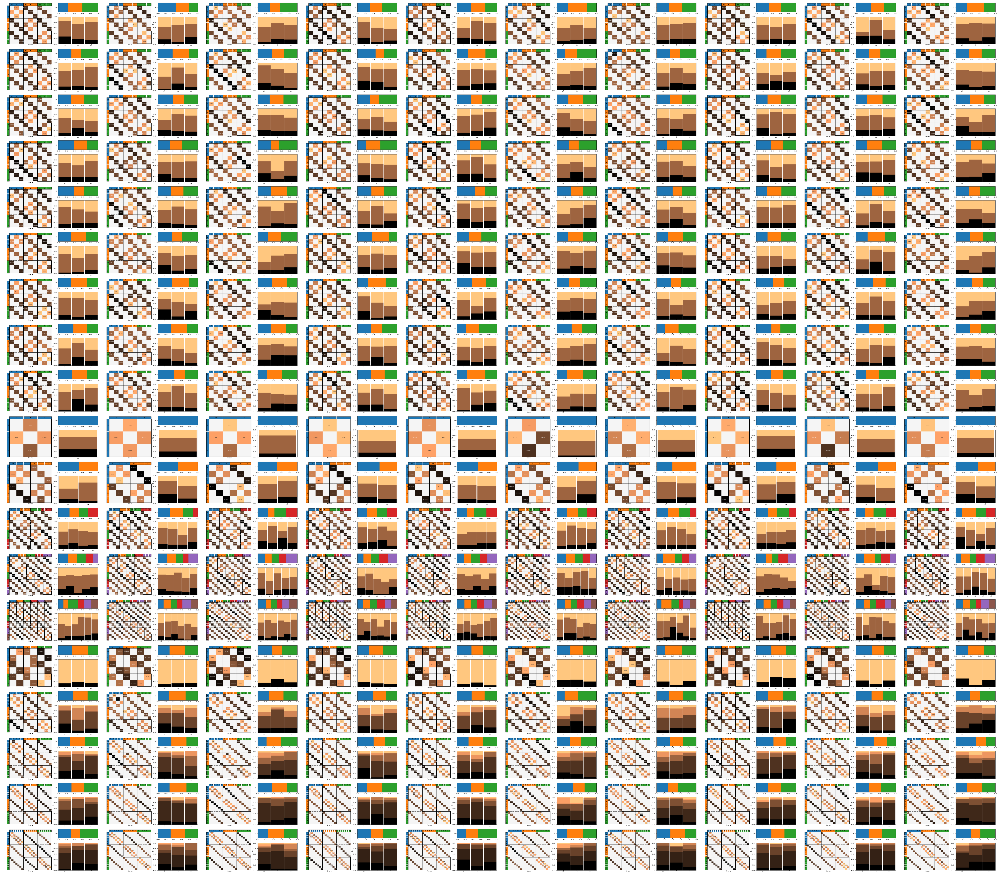

In [6]:
fig, axes = plt.subplots(
    len(conditions), 10, sharex='row', sharey='row', 
    layout='constrained', gridspec_kw=dict(wspace=0.02, hspace=0.02), 
    figsize=(40, 35), dpi=150
)

for ax in axes.flatten():
    ax.set_axis_off()
    ax.set_frame_on(False)

for cond, axr in zip(conditions.itertuples(index=False), axes):
    for rep, ax in zip(range(1, 11), axr):
        with gzip.open(SIM01_DIR/cond.conditionID/f'{cond.conditionID}-rep{rep:02d}.json.gz') as file:
            data = json.load(file)
            
        mmm = MarkovModulatedTreeModel(substmodelclass=MarkovModulatedBDARD, **data['init_model'])
        mmm.update(**data['params'])

        # extract RGB
        subfig = plt.figure(layout='constrained')
        plotMMM(mmm, subfig)
        subfig.canvas.draw()
        width, height = map(int, subfig.get_size_inches() * subfig.get_dpi())
        rgb = np.frombuffer(subfig.canvas.tostring_rgb(), dtype='uint8').reshape(height, width, 3)
        plt.close(subfig)
        
        ax.imshow(rgb, aspect='auto')